In [6]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler

## Lectura de archivo CSV

In [7]:
# df_original = pd.read_csv('..\Dataset\earthquakes-1800-2020.csv')
df_original = pd.read_csv('..\Dataset\earthquakes-1500-2021.csv')

In [8]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5652 entries, 0 to 5651
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Year                          5652 non-null   int64  
 1   Mo                            5494 non-null   float64
 2   Dy                            5387 non-null   float64
 3   Country                       5652 non-null   object 
 4   Area                          325 non-null    object 
 5   Region                        5651 non-null   float64
 6   Location Name                 5651 non-null   object 
 7   Latitude                      5611 non-null   float64
 8   Longitude                     5611 non-null   float64
 9   Focal Depth (km)              3256 non-null   float64
 10  Mag                           4264 non-null   float64
 11  MMI Int                       2577 non-null   float64
 12  Deaths                        1954 non-null   float64
 13  Dea

In [ ]:
df_original.shape

In [ ]:
def display_all(df):
    with pd.option_context("display.max_rows",1000 ,  "display.max_columns", 1000): 
        display(df)

        
display_all(df_original.describe(include='all').T)

In [ ]:
# Cambiar nombres en columas
df_etl = df_original.copy()

In [11]:
# Nos quedamos solo con variables que nos van a servir para determinar Muertes, Heridos y Daños
df_etl = df_etl[['Year', 'Mo', 'Dy','Country','Region','Location Name','Latitude', 'Longitude', 'Focal Depth (km)', 'Mag', 'MMI Int', 'Deaths','Death Description','Injuries', 'Injuries Description', 'Damage ($Mil)', 'Damage Description']]

# # Cambio de nombres en columnas
df_etl.rename(columns = {'Focal Depth (km)':'Depth','Mag':'Magnitud','MMI Int':'MMI','Damage ($Mil)':'Damage'}, inplace=True)


In [ ]:
# Función para identificar el porcentaje de valores nulos por columna
def percentage_nulls(df):
    number_nulls = pd.DataFrame(df.isnull().sum(),columns=['Total'])
    number_nulls['% nulls'] = round((number_nulls['Total'] / df.shape[0])*100,1)
    
    return number_nulls


In [ ]:
# Observar el porcentaje de nulos por varaibles
percentage_nulls(df_etl)

In [ ]:
df_etl_sin_nulos = df_etl[(~df_etl['Magnitud'].isnull()) & (~df_etl['Deaths'].isnull()) & (~df_etl['Injuries'].isnull()) & (~df_etl['Damage'].isnull()) ]
percentage_nulls(df_etl_sin_nulos)


In [ ]:
df_etl_sin_nulos = df_etl_sin_nulos.drop(columns='MMI')
df_etl_sin_nulos.dropna(inplace=True)
percentage_nulls(df_etl_sin_nulos)

In [ ]:
df_etl_sin_nulos.describe()

In [ ]:
sns.set_theme(style='whitegrid')
ax = sns.boxplot(x=df_etl_sin_nulos['Deaths'])

In [ ]:
sns.violinplot(x=df_etl_sin_nulos['Deaths'])

In [ ]:
q1, q3 = np.percentile(df_etl_sin_nulos['Deaths'],[25,75])
iqr = q3 - q1 # rango intercuantil es el tamaño de la caja
upper = q3 + (3*iqr)
lower = q1 - (3*iqr)

print('Límite inferior caja: ', q1)
print('Limite superior caja: ', q3)
print('Rango intercuantil: ', iqr)
print('LImite superior: ', upper)
print('LImite inferior: ', lower)

In [ ]:
df_etl_deaths = df_etl_sin_nulos[df_etl_sin_nulos['Deaths'] <= upper]

In [ ]:
df_etl_deaths.shape

In [ ]:
# Imputando datos mediante regresión lineal para Profundidad (Depth)
df_etl_death = df_etl_deaths[['Depth','Magnitud','Deaths','Death Description']]

In [ ]:
# Se crean los set de datos para entrenar el modelo
X = df_etl_death.drop(columns=['Death Description'])
y = df_etl_death['Death Description']

#Escalando datos para mejorar la precisión
scaler = StandardScaler()
# scaler = MinMaxScaler()
X_t = scaler.fit_transform(X)


#Creando set de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2) 

# Entrenando el modelo
# modelo_LR = LinearRegression()
modelo_LR = LogisticRegression()
modelo_LR.fit(X_train, y_train)


In [ ]:
modelo_LR.coef_

In [ ]:
modelo_LR.intercept_

In [ ]:
train_score = modelo_LR.score(X_train, y_train)
test_score = modelo_LR.score(X_test, y_test)

print(train_score)
print(test_score)

In [ ]:
y_predict = modelo_LR.predict(X_test)

In [ ]:
df_pred = pd.DataFrame({'Actual':y_test,'Predicted':y_predict})
df_pred

In [ ]:
# [['Depth','Magnitud','Deaths','Death Description']]
df_test_deaths = df_etl_sin_nulos[['Depth','Magnitud','Deaths', 'Death Description']]

In [ ]:
y_predict = modelo_LR.predict(df_test_deaths.drop(columns=['Death Description']))
df_test_deaths['Describe_Death_Predicted'] = y_predict
df_test_deaths.shape

In [ ]:
df_etl[~df_etl['Deaths'].isnull()].shape

In [ ]:
r2 = modelo_LR.score(X_train, y_train)
print('R2: ', r2)

In [ ]:
y_test

In [ ]:
y_predict

In [ ]:
df_original[df_original['Focal Depth (km)'].isnull()].shape

In [ ]:
df_etl_completo.info()

In [ ]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5, weights="uniform")

imputer.fit(df_etl[['Damage']])
df_etl['Damage'] = imputer.transform(df_etl[['Damage']]).ravel()

In [ ]:
plt.boxplot(data=df_etl, x='Damage')
plt.show()

In [ ]:
df_etl.head(50)

<AxesSubplot:>

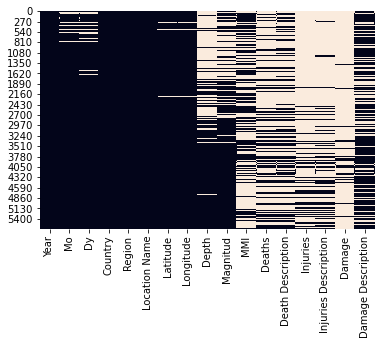

In [13]:
sns.heatmap(df_etl.isnull(), cbar=False)

In [14]:
df_etl_clean = df_etl[~df_etl['Depth'].isnull()]
df_etl_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3256 entries, 16 to 5651
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Year                  3256 non-null   int64  
 1   Mo                    3248 non-null   float64
 2   Dy                    3246 non-null   float64
 3   Country               3256 non-null   object 
 4   Region                3255 non-null   float64
 5   Location Name         3255 non-null   object 
 6   Latitude              3256 non-null   float64
 7   Longitude             3256 non-null   float64
 8   Depth                 3256 non-null   float64
 9   Magnitud              3185 non-null   float64
 10  MMI                   1306 non-null   float64
 11  Deaths                1309 non-null   float64
 12  Death Description     1375 non-null   float64
 13  Injuries              1168 non-null   float64
 14  Injuries Description  1319 non-null   float64
 15  Damage              

<AxesSubplot:>

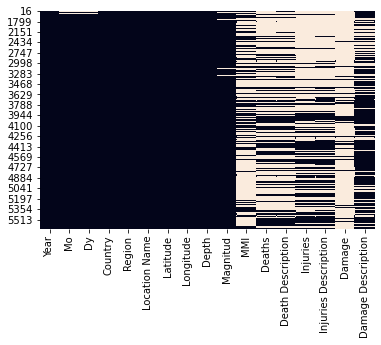

In [15]:
sns.heatmap(df_etl_clean.isnull(), cbar=False)

In [16]:
df_etl_clean[df_etl_clean['Magnitud'].isnull()].shape

(71, 17)

<AxesSubplot:>

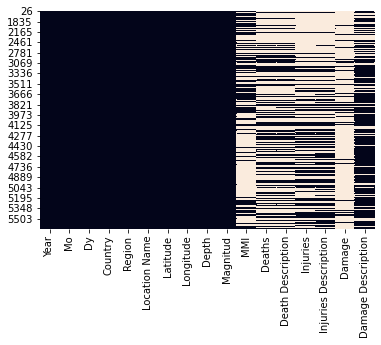

In [17]:
df_etl_clean = df_etl_clean[~df_etl_clean['Magnitud'].isnull()]
sns.heatmap(df_etl_clean.isnull(), cbar=False)

In [18]:
df_etl_clean.columns

Index(['Year', 'Mo', 'Dy', 'Country', 'Region', 'Location Name', 'Latitude',
       'Longitude', 'Depth', 'Magnitud', 'MMI', 'Deaths', 'Death Description',
       'Injuries', 'Injuries Description', 'Damage', 'Damage Description'],
      dtype='object')

In [19]:
df_etl_deaths = df_etl_clean[['Year', 'Mo', 'Dy', 'Location Name', 'Latitude', 'Longitude', 'Depth','Magnitud', 'MMI', 'Deaths', 'Death Description']]
df_etl_injuries = df_etl_clean[['Year', 'Mo', 'Dy', 'Location Name', 'Latitude', 'Longitude', 'Depth','Magnitud', 'MMI', 'Injuries', 'Injuries Description']]
df_etl_damage = df_etl_clean[['Year', 'Mo', 'Dy', 'Location Name', 'Latitude', 'Longitude', 'Depth', 'Magnitud', 'MMI', 'Damage', 'Damage Description']]

In [ ]:
df_etl_deaths.head()

In [ ]:
df_etl_injuries.head()

In [ ]:
df_etl_damage.head()

<AxesSubplot:>

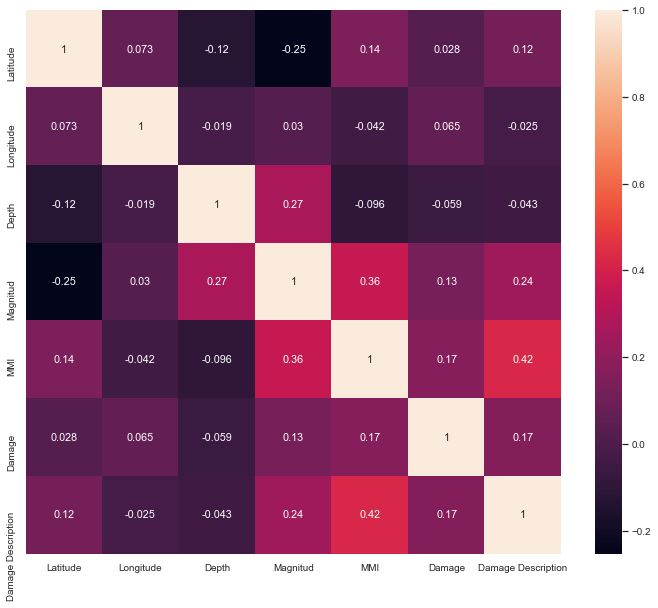

In [20]:
plt.figure(figsize=(12,10))
sns.set(font_scale = 0.9)
sns.heatmap(df_etl_damage.drop(['Year','Mo','Dy'], axis=1).corr(), annot=True)

<AxesSubplot:>

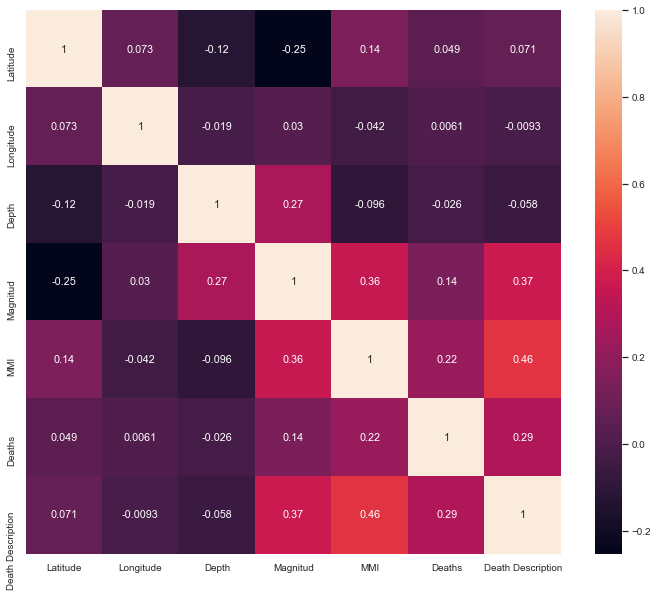

In [21]:
plt.figure(figsize=(12,10))
sns.set(font_scale = 0.9)
sns.heatmap(df_etl_deaths.drop(['Year','Mo','Dy'], axis=1).corr(), annot=True)

<AxesSubplot:>

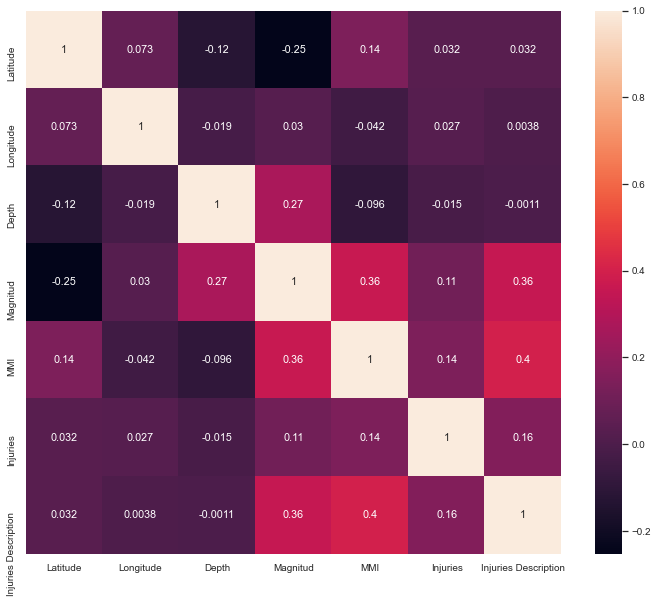

In [22]:
plt.figure(figsize=(12,10))
sns.set(font_scale = 0.9)
sns.heatmap(df_etl_injuries.drop(['Year','Mo','Dy'], axis=1).corr(), annot=True)

In [ ]:
df_etl_clean.describe()

In [ ]:
sns.histplot(data=df_etl,x='Depth')

In [ ]:
df_etl.Depth.describe()

In [ ]:
sns.boxplot(data=df_etl, x='Depth')

In [ ]:
df_etl_depth = df_etl[df_etl['Depth'] >= 38]
print('Profundidad mayor a 38Km: ',df_etl_depth.shape[0])
print('Registros totales: ',df_etl.shape[0])

por_info = df_etl_depth.shape[0]/df_etl.shape[0]
print('Procentaje de outliers: ', por_info * 100)

In [ ]:
percentage_nulls(df_etl_clean)

In [ ]:
df_etl_clean.head (3)

In [ ]:
df_clean_num = df_etl_clean.select_dtypes(np.number)
df_clean_num.head()

In [ ]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5, weights="uniform")

imputer.fit(df_clean_num[['Deaths']])
df_clean_num['Deaths'] = imputer.transform(df_clean_num[['Deaths']]).ravel()


In [ ]:
# missing_columns = ['Deaths', 'Injuries','Damage']
df_clean_num.info()

In [ ]:
def random_imputation(df, feature):
    number_missing = df[feature].isnull().sum()
    observed_values = df.loc[df[feature].notnull(), feature]
    df.loc[df[feature].isnull(), feature + '_imp'] = np.random.choice(observed_values, number_missing, replace = True)
    
    return df

In [ ]:
# por cada coumna se agrega el valor nuevo generado para los valores NULOS
for feature in missing_columns:
    df_clean_num[feature + '_imp'] = df_clean_num[feature]
    df_clean_num = random_imputation(df_clean_num, feature)

In [ ]:
df_clean_num.head()

In [ ]:
# df_clean_num = df_clean_num[df_clean_num['Deaths'] < 316000]
df_clean_num[['Deaths', 'Injuries', 'Damage']].describe()

In [ ]:
from sklearn.linear_model import LinearRegression


random_data = pd.DataFrame(columns = ["Ran" + name for name in missing_columns])

for feature in missing_columns:
    print(feature)
    random_data["Ran" + feature] = df_clean_num[feature + '_imp']
    parameters = list(set(df_clean_num.columns) - set(missing_columns) - {feature + '_imp'})
    
    model = LinearRegression()
    model.fit(X = df_clean_num[parameters], y = df_clean_num[feature + '_imp'])
    
    #Standard Error of the regression estimates is equal to std() of the errors of each estimates
    predict = model.predict(df_clean_num[parameters])
    std_error = (predict[df_clean_num[feature].notnull()] - df_clean_num.loc[df_clean_num[feature].notnull(), feature + '_imp']).std()
    
    #observe that I preserve the index of the missing data from the original dataframe
    random_predict = np.random.normal(size = df_clean_num[feature].shape[0], loc = predict,  scale = std_error)
    random_data.loc[(df_clean_num[feature].isnull()) & (random_predict > 0), "Ran" + feature] = random_predict[(df_clean_num[feature].isnull()) & (random_predict > 0)]

In [ ]:
random_data.head()

In [ ]:
# Por lo observado, Tsunami y Volcan se pueden rellenar con CEROS ya que solo sería una bandera dentro del set de datos
# MMI se debe imputar los valores de acuerdo a la media 
# Descartar todas la columnas cuyo nombre inician con Total ya que es donde hay más falta de valores.